# Simulating Electrostatic Potentials on 2D Geometries
##### "Maximally Boring" Solutions Made Interesting (Hopefully)

David Neese

3/10/22

### Roadmap and Theory

In this notebook I hope to make some 3D plots of the solution to Laplace's equation on some simple geometries. The relaxation algorithm is used to find the solution to each given set of boundary conditions, and I aim to show the elegance of these solutions when given just a bit of time and computational power. I also aim to show the difference SOR makes compared to more standard Jacobi relaxation, in a fun visual way.

We use both the Jacobi and SOR methods to find a convergent solution to Laplace. Both are made simpler by setting the Laplacian to zero - there is no $ C\ D(x_i)\ h^2$ term.

Jacobi:

$$
\Phi_i = \frac{1}{4}\left( \Phi_{i(j+1)} + \Phi_{i(j-1)} + \Phi_{(i+1)j} + \Phi_{(i-1)j} \right) 
$$

SOR:

$$
\Phi_i^{n+1} = (1-\omega)\ \Phi_i^n + \omega/4\ \left( \Phi^n_{i(j+1)} + \Phi^n_{i(j-1)} + \Phi^n_{(i+1)j} + \Phi^n_{(i-1)j} \right)
$$

The latter method makes use of the most recently updated values at each step, resulting in faster convergence. It also employs a weighting constant, $1 \leq \omega \leq 2$, which can be optimized for the specific problem. It cannot be found analytically in most cases, but it is related to the discretization of the region of interest - for large values of $n$ (on an $n \times n$ grid), the optimal $\omega$ nears $2$.

### Building a General Solver

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import math
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
plt.rcParams['figure.figsize'] = (12, 8)

In [2]:
#The method of Successive Over-Relaxation
#This method takes: (1) psi: a boundary condition and region over which to solve Laplace's equation
#                   (2) n: the dimensions of our region of interest
#                   (3) w: the omega parameter
#                   (4) maxit, tolerance: two variables set to stop the method at convergence - either at maximum iterations, or once the iterations stop improving by 1e-5
#This method returns: the initial psi grid with Laplace's equation solved in the middle

def sor(psi, n, w, maxit=1000, tolerance=1e-5, prints='print'):

    history = [] #this function not only returns a solved geometry, but also an array of that geometry at each iteration of the relaxation algorithm.
                 #this will later be used for animation purposes
    for iterations in range(maxit):
        psi_last = psi.copy()
        history.append(psi.copy())
        for i in range(1, n-1): #we iterate over each element on the grid instead of using a np array, so we can use updated values at every step
            for j in range(1, n-1):
                sigma = (psi[i, j-1] + psi[i, j+1]
                        + psi[i+1, j] + psi[i-1, j])
                psi[i, j] += w*(sigma/4 - psi[i, j])

        if iterations % 5 == 0: #tests for convergence every five iterations
            if np.sum(np.abs(psi - psi_last))/np.sum(psi_last) <= tolerance: #measures the total difference between each iteration and the previous one
                if (prints == 'print'):
                    print(f"Convergence with {iterations+1} iterations")
                break

    if prints == 'print' and iterations == maxit - 1:
        print("Maximum number of iterations hit")

    return psi, history, iterations

In [3]:
#The method of Jacobi Relaxation
#This method takes: (1) psi: a boundary condition and region over which to solve Laplace's equation
#                   (2) n: the dimensions of our region of interest
#                   (3) maxit, tolerance: two variables set to stop the method at convergence - either at maximum iterations, or once the iterations stop improving by 1e-5
#This method returns: the initial psi grid with Laplace's equation solved in the middle

def jacobi(psi, n, maxit=10000, tolerance=1e-5):
    iterations = 1
    psi_new = psi.copy() #use to check convergence below

    history = []
    for iterations in range(maxit):
        history.append(psi.copy())
        psi_new[1:n-1, 1:n-1] = (psi[1:n-1, :(n-2)] + psi[1:n-1, 2:]
                                + psi[2:, 1:n-1] + psi[:n-2, 1:n-1])/4

        if iterations % 60 == 0:
            if np.sum(np.abs(psi_new - psi))/np.sum(psi) <= tolerance:
                print(f"Convergence with {iterations} iterations")
                break

        psi = psi_new.copy() #too many copies?

    if iterations == maxit - 1:
        print("Maximum number of iterations hit")

    return psi, history, iterations

A quick note here: I've made two plotting methods, one to give us our main 3D surface plot in a large size, and the other to give us two smaller plots (the 3D plot and a color map side by side). I employ both together and separately in different parts of the notebook - it may seem redundant, but it's nice to have both.

In [4]:
#The standard plotting method - we plot the electrostatic potential of the geometry as a scalar field above the grid.
#This is a nice way of visualizing our systems, because we can see how a charged particle might "fall down" these potentials
def plotPotential(psi, n):
    x = y = np.linspace(0, 1, n)
    x,y = np.meshgrid(x,y)
    fig = plt.figure()
    ax = plt.axes(projection='3d')
    plt1 = ax.plot_surface(x, y, psi, rstride=1, cstride=1, cmap= 'coolwarm', edgecolor = 'none')
    ax.set_title('Electrostatic Potential')
    ax.set_xlabel("$x$")
    ax.set_ylabel("$y$")
    fig.colorbar(plt1)
    ax.view_init(40,30)


In [5]:
#We produce two plots of the potential - one a simple color map, the other the 3D graph of the potential. 
def plotPotential2(psi, n):

    fig = plt.figure()
    plt.rcParams['figure.figsize'] = (12, 8)

    #3D Electrostatic Potential Graph
    x = y = np.linspace(0, 1, n)
    x,y = np.meshgrid(x,y)
    ax0 = fig.add_subplot(211, projection='3d')
    plt0 = ax0.plot_surface(x, y, psi, rstride=1, cstride=1, cmap= 'coolwarm', edgecolor = 'none')
    ax0.set_title('Electrostatic Potential: 3D Plot')
    ax0.set_xlabel("$x$")
    ax0.set_ylabel("$y$")
    ax0.view_init(40,30)

    #2D Color Plot
    x2 = np.linspace(0, 1, n)
    ax1 = fig.add_subplot(231)
    plt1 = ax1.contourf(x2, x2, psi, 20, cmap='coolwarm')
    ax1.set_title('Electrostatic Potential: Color Map')
    ax1.set_xlabel("$x$")
    ax1.set_ylabel("$y$")
    fig.colorbar(plt1)

    plt.tight_layout()

### Trying Out Some Initial Conditions

These initial conditions are all on an $n \times n$ grid: we fix the borders of the region, and solve Laplace on the inside. This works out well - we can use the relaxation formula of equating each point to the average of the points around it without having to worry about pesky off-by-one errors at the edges - all points of interest to the solver will have surrounding points defined.

##### One edge hot, three cold

A grid with one side set to potential $\Phi = 1$, and the other three grounded

In [6]:
def simpleBC(n):
    psi_i = np.zeros((n,n))
    psi_i[0,:n] = 1 #defining one boundary as hot
    return psi_i

Convergence with 66 iterations


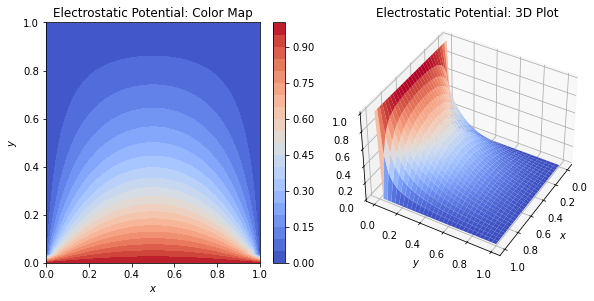

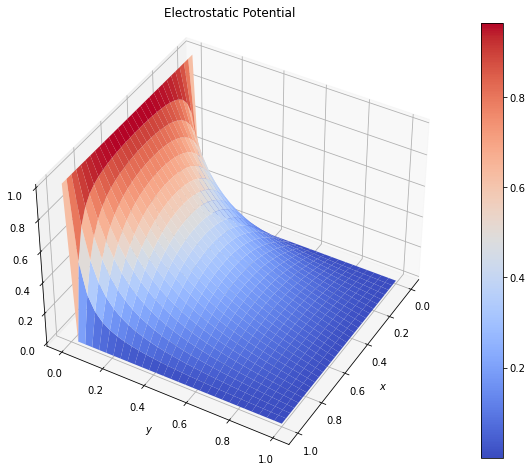

In [7]:
n = 30
psi_i = simpleBC(n)
psi = sor(psi_i, n, 1.85, 1000, 1e-5)[0]
plotPotential2(psi, n)
plotPotential(psi, n)

##### Two edges hot

This one looks very satisfying. Opposite sides are set to $\Phi = 1$.

In [8]:
def simpleBC2(n):
    psi_i = np.zeros((n,n))
    psi_i[0,:n] = 1 #defining one boundary as hot
    psi_i[-1,:n] = 1
    return psi_i

Convergence with 66 iterations


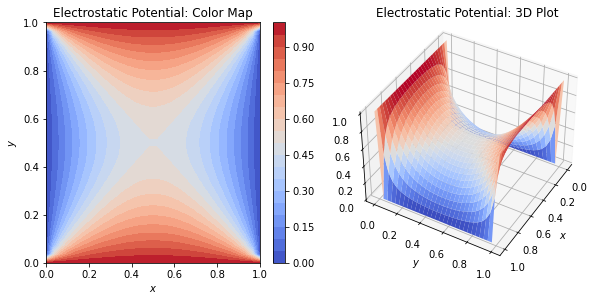

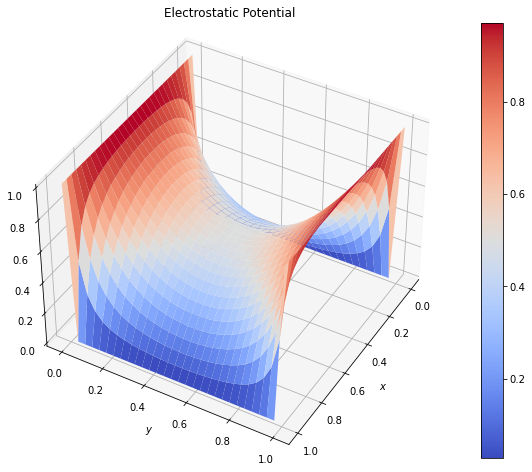

In [9]:
n = 30
psi_i = simpleBC2(n)
psi = sor(psi_i, n, 1.80, 1000, 1e-5)[0]
plotPotential2(psi, n)
plotPotential(psi, n)

##### Parallel Plate Capacitors

The intent of this boundary condition is to show the fringing of plate capacitors, and how the assumptions we make in calculating the potential between capacitors break down slightly when the capacitors are small and relatively far apart compared with their area.

Unfortunately, this isn't the most accurate model - what would be better is if we could mask out areas in our initial grid to tell the general solver to solve on - this would allow us to put two plate capacitors in the center of the grid fading out to zero further out (rather than immediately being grounded outside each plate). It would also allow us to adjust the space between the capacitors better, and to see the potential on the other side of them.

In [10]:
def capacitorBC(n):
    psi_i = np.zeros((n,n))
    # psi_i[int(2*n/5), int(n/4):int(3*n/4)] = 1
    # psi_i[int(3*n/5), int(n/4):int(3*n/4)] = -1
    psi_i[0, int(n/4):int(3*n/4)] = 1
    psi_i[-1, int(n/4):int(3*n/4)] = -1
    return psi_i

C:\Users\chopi\AppData\Local\Temp/ipykernel_28212/3919018926.py:22: RuntimeWarning: divide by zero encountered in double_scalars
  if np.sum(np.abs(psi - psi_last))/np.sum(psi_last) <= tolerance: #measures the total difference between each iteration and the previous one


Convergence with 31 iterations


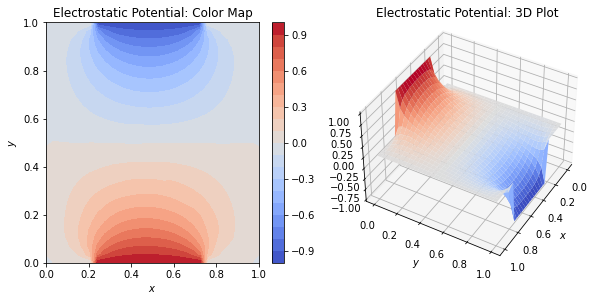

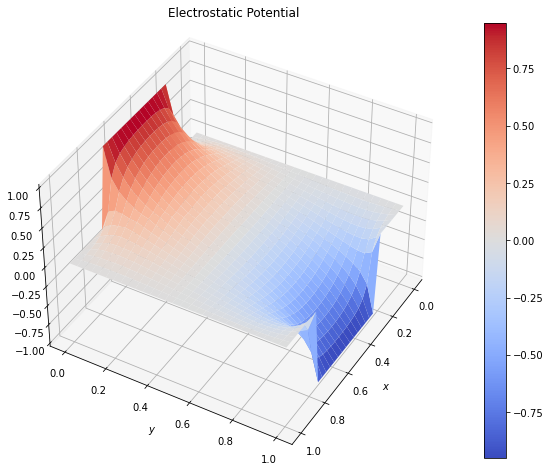

In [11]:
n = 30
psi_i = capacitorBC(n)
psi = sor(psi_i, n, 1.85, 1000, 1e-5)[0]
plotPotential2(psi, n)
plotPotential(psi, n)

##### Sine waves on the boundaries

Now we try putting a more interesting function on the boundary. Laplace's maximally boring solution means we get something very similar to our model above.

In [12]:
def sinBC(n):
    cycles = 4
    psi_i = np.zeros((n,n))
    vals = 1 + 0.25*np.sin(cycles*2*np.pi*np.arange(0,n)/n)
    psi_i[0,:n] = vals #defining one boundary as hot
    psi_i[:n,0] = vals / 2
    return psi_i

Convergence with 61 iterations


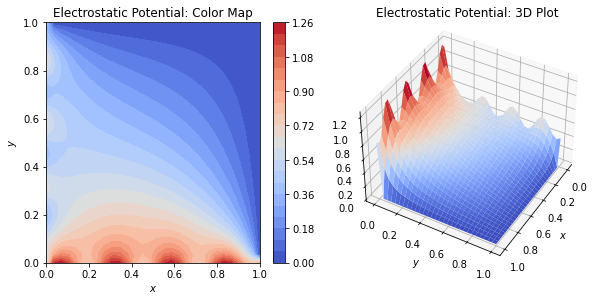

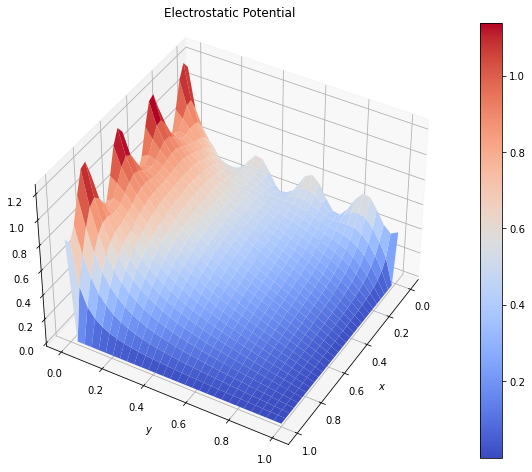

In [13]:
n = 30
psi_i = sinBC(n)
psi = sor(psi_i, n, 1.80, 1000, 1e-5)[0]
plotPotential2(psi, n)
plotPotential(psi, n)

##### A piecewise function, in case you were interested

A humble piecewise function. We can see once again the power of relaxation - an analytical solution to this would be a nightmare to obtain with its asymmetry; relaxation handles it like a champ.

In [14]:
def piecewiseBC(n):
    psi_i = np.zeros((n,n))
    psi_i[0, :int(n/3)] = 1
    psi_i[:int(n/3), 0] = 1
    psi_i[0, int(n/3):int(2*n/3)] = np.linspace(1, 0, int(n/3))**0.5
    psi_i[int(n/3):int(2*n/3), 0] = np.linspace(1, 0, int(n/3))**2
    return psi_i

Convergence with 56 iterations


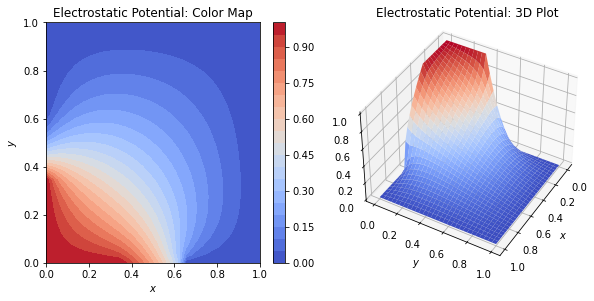

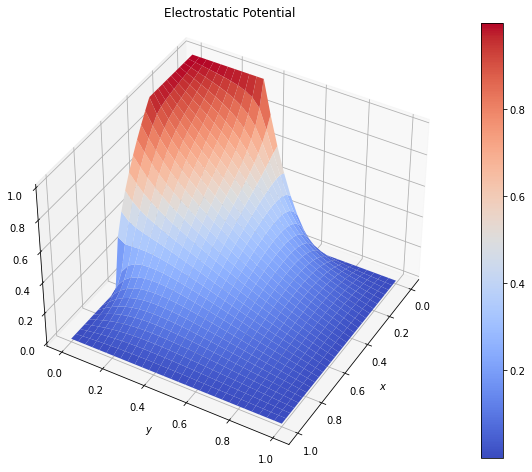

In [15]:
n = 30
psi_i = piecewiseBC(n)
psi = sor(psi_i, n, 1.80, 1000, 1e-5)[0]
plotPotential2(psi, n)
plotPotential(psi, n)

### A Quick Experiment - Fiddling with the $\omega$ Parameter

Here we run the SOR method on two different geometries at two different n values, watching for the effect on optimal $\omega$. We see both distributions are optimized at around $\omega = 1.8$, and in this case, $n$ has a greater effect than geometry.

In [16]:
def graphW(psi, n, title):

    x = np.arange(1, 2, 0.05)
    iterations = x.copy()
    index = 0

    for w in x:
        psi_i = psi.copy() #must wipe the psi variable before each iteration
        iterations[index] = sor(psi_i, n, w, 1000, 1e-5, 'noprint')[2]
        index += 1

    plt.plot(x, iterations)
    plt.xlabel('$\omega$')
    plt.ylabel('Iterations before convergence')
    plt.title(title)
    plt.show()

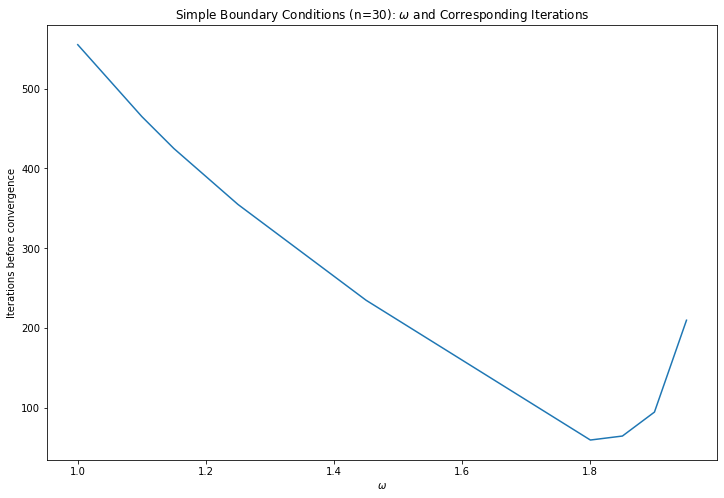

In [17]:
graphW(simpleBC(30), 30, 'Simple Boundary Conditions (n=30): $\omega$ and Corresponding Iterations')

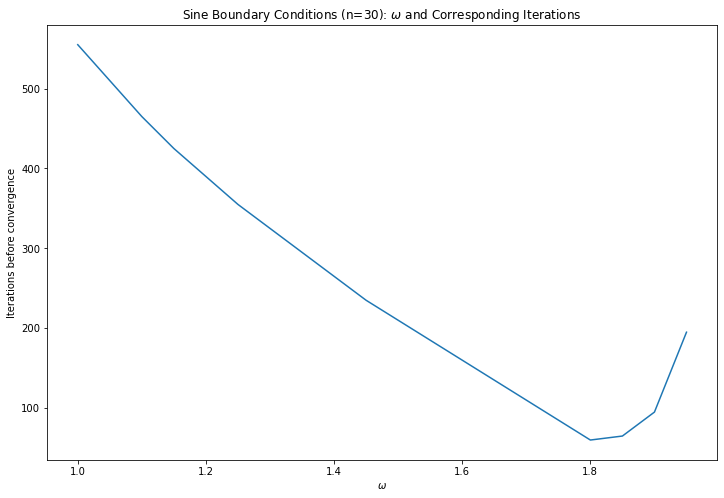

In [18]:
graphW(sinBC(30), 30, 'Sine Boundary Conditions (n=30): $\omega$ and Corresponding Iterations')

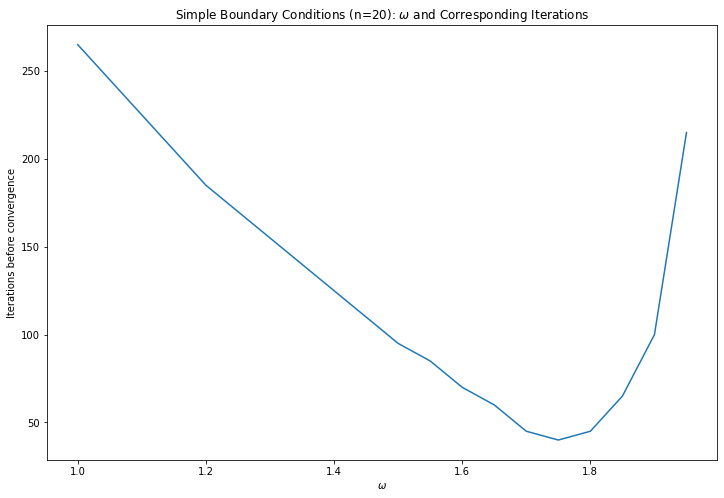

In [19]:
graphW(simpleBC(20), 20, 'Simple Boundary Conditions (n=20): $\omega$ and Corresponding Iterations')

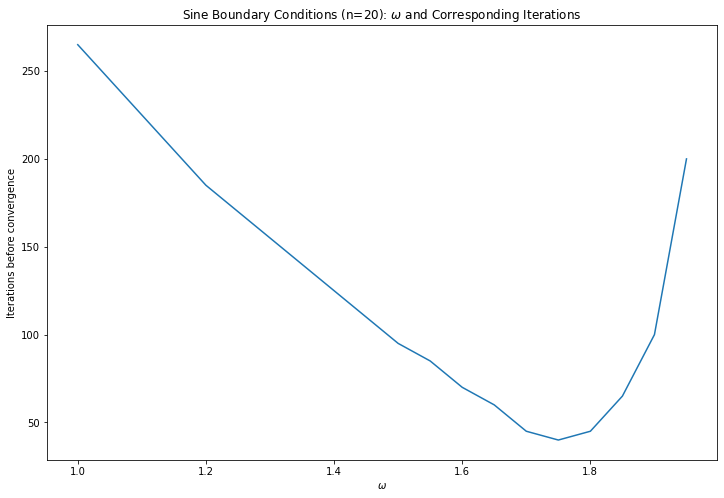

In [20]:
graphW(sinBC(20), 20, 'Sine Boundary Conditions (n=20): $\omega$ and Corresponding Iterations')

### Comparing successive over-relaxation and standard relaxation - how much time do we really gain?

Here we take the maximally efficient (by the $\omega$ parameter) SOR algorithm and put it up against jacobi relaxation. Instead of running more standard time trials, here we visualize the difference by animating both methods with equal framerates!

Convergence with 66 iterations


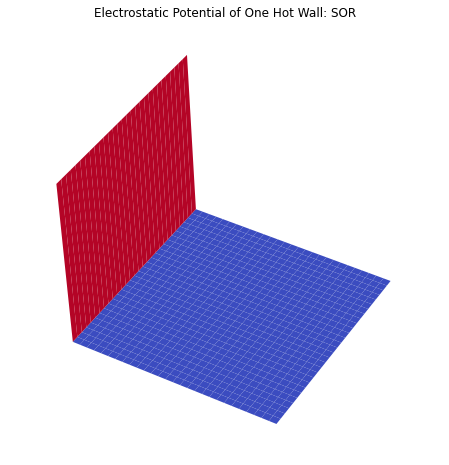

In [21]:
x = y = np.linspace(0, 1, n)
x,y = np.meshgrid(x,y)

n = 30
psi_i = simpleBC(n)
results = sor(psi_i, n, 1.85, 1000, 1e-5)
history = results[1]
maxIters = results[2]

def update(frame_number, history, plot):
   plot[0].remove()
   plot[0] = ax.plot_surface(x, y, history[frame_number], cmap = 'coolwarm')

fig = plt.figure()
ax = plt.axes(projection='3d')
ax.set_title('Electrostatic Potential of One Hot Wall: SOR')
#fig.colorbar(plt1)

plot = [ax.plot_surface(x, y, history[0], cmap='coolwarm', rstride=1, cstride=1)]

ax.set_zlim(0, 1)
ax.view_init(40,30)

fps = 8 #frames per second
frn = maxIters #total frames
ani = FuncAnimation(fig, update, frn, fargs=(history, plot), interval=1000/fps)

ax.axis('off')

#plt.show()
HTML(ani.to_jshtml())

Convergence with 1020 iterations


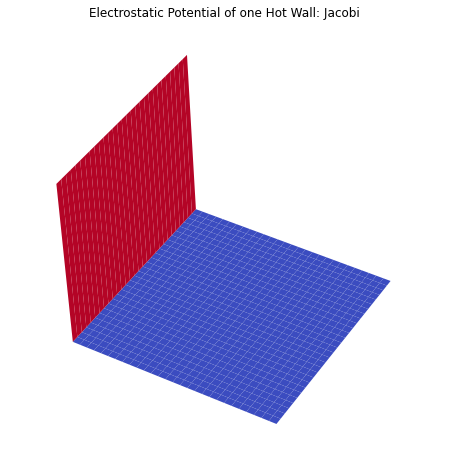

In [22]:
x = y = np.linspace(0, 1, n)
x,y = np.meshgrid(x,y)

n = 30
psi_i = simpleBC(n)
results = jacobi(psi_i, n)
history = results[1]
maxIters = results[2]

skip = 1

def update(frame_number, history, plot):
   plot[0].remove()
   plot[0] = ax.plot_surface(x, y, history[frame_number*skip], cmap = 'coolwarm')

fig = plt.figure()
ax = plt.axes(projection='3d')
ax.set_title('Electrostatic Potential of one Hot Wall: Jacobi')
#fig.colorbar(plt1)

plot = [ax.plot_surface(x, y, history[0], cmap='coolwarm', rstride=1, cstride=1)]

ax.set_zlim(0, 1)
ax.view_init(40,30)

fps = 8 #frames per second
frn = 70 #number of frames #int(maxIters / skip)
ani2 = FuncAnimation(fig, update, frn, fargs=(history, plot), interval=1000/fps)

ax.axis('off')

#plt.show()
HTML(ani2.to_jshtml())

Here we see a stark contrast both in process and in timing results - while the Jacobi method is visualized in an easily understandable way, pulling up each slice of the grid from the hot side outwards, the SOR method seems to sweep across in both directions simultaneously. The result of this is that in our roughly 7 second animation, the SOR method converges with time to spare, and the Jacobi method is still chugging along. We can also see the difference in iterations - 1020 vs 66!

### Bonus: Another Fun Distribution with Animated SOR

I've tweaked the $\omega$ parameter here to be suboptimal - the animations turn out better that way, and we can see more clearly what's actually happening as the solution converges.

Convergence with 171 iterations


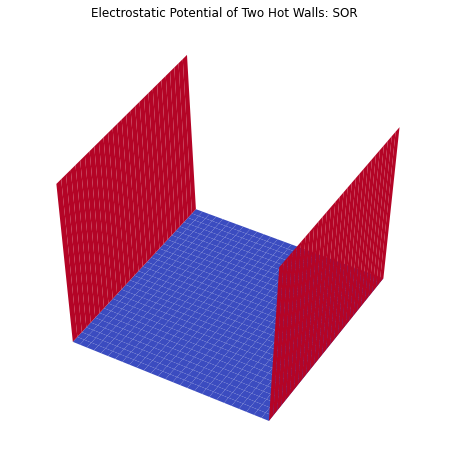

In [ ]:
x = y = np.linspace(0, 1, n)
x,y = np.meshgrid(x,y)

n = 30
psi_i = simpleBC2(n)
results = sor(psi_i, n, 1.94, 1000, 1e-5)
history = results[1]
maxIters = results[2]

def update(frame_number, history, plot):
   plot[0].remove()
   plot[0] = ax.plot_surface(x, y, history[frame_number], cmap = 'coolwarm')

fig = plt.figure()
ax = plt.axes(projection='3d')
ax.set_title('Electrostatic Potential of Two Hot Walls: SOR')
#fig.colorbar(plt1)

plot = [ax.plot_surface(x, y, history[0], cmap='coolwarm', rstride=1, cstride=1)]

ax.set_zlim(0, 1)
ax.view_init(40,30)

fps = 8 #frames per second
frn = 100 #number of frames
ani = FuncAnimation(fig, update, frn, fargs=(history, plot), interval=1000/fps)

ax.axis('off')

#plt.show()
HTML(ani.to_jshtml())

### Further Directions

- Modify solver to solve geometries with boundary conditions of arbitrary shape
    - For example: mark areas to solve with 1, areas to ignore with 0, and define boundary around the 1s. Apply a mask and solve. (A possbile extension - you could even mark out areas to solve with a color, and create a solver that takes handdrawn bitmaps from ms paint)
    - This would allow a proper parallel plate capacitor simulation, as well as ring geometries.
- Add a test particle
    - Also a way to incorporate stream plots and the gradient of the potential

#### Sources

- This sample notebook on potentials: https://nbviewer.org/urls/www.numfys.net/media/notebooks/relaxation_methods.ipynb#rsc1

- Numpy and Matplotlib documentation